# Analysis and preprocessing images for 'Road Damage Detection".
**Course:** 
> Image Processing

**Team members:**
> Luz Maria

>  Iván Valadez

**References**
> The model and dataset were taken from [GitHub](https://github.com/sekilab/RoadDamageDetector) and [Cornell University](https://arxiv.org/abs/1801.09454)

**Introduction**
> This project is about analysing and preprocessing images before pass them to an algorithm of road damage detection.

**Goals**
> Use image analisys and preprocessing for the performance improvement of the chosen algorithm from the article. 

**Metodology**
> Applying methods of image modifications as Blur, Contrast, noise Salt & Pepper, and equalization to the input images to see how it affects the detection.

**Results and Conclusions**
> [Youtube Video]()

> [Our GitHub](https://github.com/ivaladez-09/Image_Procesing_RoadDamageDetection)


## Data

### Download Dataset and Models

In [ ]:
import six.moves.urllib as urllib
import os

In [ ]:
try:
    import urllib.request
except ImportError:
    raise ImportError('You should use Python 3.x')

if not os.path.exists('./RoadDamageDataset.tar.gz'):
    url_base = 'https://mycityreport.s3-ap-northeast-1.amazonaws.com/02_RoadDamageDataset/RoadDamageDataset.tar.gz'
    urllib.request.urlretrieve(url_base, './RoadDamageDataset.tar.gz')
    
    print("Download RoadDamageDataset.tar.gz Done")
    
else:
    print("You have RoadDamageDataset.tar.gz")

Download RoadDamageDataset.tar.gz Done


In [ ]:
if not os.path.exists('./trainedModels.tar.gz'):
    url_base = 'https://mycityreport.s3-ap-northeast-1.amazonaws.com/02_RoadDamageDataset/public_data/Japan/CACAIE2018/trainedModels.tar.gz'
    urllib.request.urlretrieve(url_base, './trainedModels.tar.gz')
    
    print("Download trainedModels.tar.gz Done")
    
else:
    print("You have trainedModels.tar.gz")

Download trainedModels.tar.gz Done


In [ ]:
# this procces may take a few minutes
!tar -zxf ./RoadDamageDataset.tar.gz
!tar -zxf ./trainedModels.tar.gz

Validate the new folder was uploaded

In [ ]:
!ls -l

total 1900088
drwxr-xr-x 10  501 staff       4096 Jan 15  2018 RoadDamageDataset
-rw-r--r--  1 root root  1872073763 Dec 16 04:05 RoadDamageDataset.tar.gz
drwxr-xr-x  1 root root        4096 Dec  2 22:04 sample_data
drwxrwxr-x  2 1000  1000       4096 Mar  2  2020 trainedModels
-rw-r--r--  1 root root    73596187 Dec 16 04:05 trainedModels.tar.gz


### Information of the Dataset

In [ ]:
from xml.etree import ElementTree
from xml.dom import minidom
import collections

import os

import matplotlib.pyplot as plt
import matplotlib as matplot
import seaborn as sns
%matplotlib inline

In [ ]:
base_path = os.getcwd() + '/RoadDamageDataset/'
damageTypes=["D00", "D01", "D10", "D11", "D20", "D40", "D43", "D44"]
# govs corresponds to municipality name.
govs = ["Adachi", "Chiba", "Ichihara", "Muroran", "Nagakute", "Numazu", "Sumida"]

In [ ]:
# the number of each class labels for each municipality
for gov in govs:
    cls_names = []
    total_images = 0
    file_list = [filename for filename in os.listdir(base_path + gov + '/Annotations/') if not filename.startswith('.')]

    for file in file_list:

        total_images = total_images + 1
        if file =='.DS_Store':
            pass
        else:
            infile_xml = open(base_path + gov + '/Annotations/' +file)
            tree = ElementTree.parse(infile_xml)
            root = tree.getroot()
            for obj in root.iter('object'):
                cls_name = obj.find('name').text
                cls_names.append(cls_name)
    print(gov)
    print("# of images：" + str(total_images))
    print("# of labels：" + str(len(cls_names)))
    
    count_dict = collections.Counter(cls_names)
    cls_count = []
    for damageType in damageTypes:
        print(str(damageType) + ' : ' + str(count_dict[damageType]))
        cls_count.append(count_dict[damageType])
        
    print('**************************************************')

Adachi
# of images：1650
# of labels：2924
D00 : 529
D01 : 1013
D10 : 153
D11 : 279
D20 : 172
D40 : 11
D43 : 191
D44 : 567
**************************************************
Chiba
# of images：467
# of labels：797
D00 : 183
D01 : 187
D10 : 13
D11 : 12
D20 : 27
D40 : 3
D43 : 104
D44 : 267
**************************************************
Ichihara
# of images：254
# of labels：482
D00 : 175
D01 : 71
D10 : 18
D11 : 9
D20 : 43
D40 : 8
D43 : 20
D44 : 138
**************************************************
Muroran
# of images：2145
# of labels：3601
D00 : 671
D01 : 574
D10 : 124
D11 : 88
D20 : 1192
D40 : 189
D43 : 50
D44 : 712
**************************************************
Nagakute
# of images：1366
# of labels：2302
D00 : 482
D01 : 477
D10 : 169
D11 : 58
D20 : 351
D40 : 14
D43 : 90
D44 : 659
**************************************************
Numazu
# of images：2032
# of labels：3711
D00 : 560
D01 : 807
D10 : 245
D11 : 129
D20 : 735
D40 : 165
D43 : 161
D44 : 908
************************************

###Visualization

In [ ]:
import cv2
import random

In [ ]:
def draw_images(image_file):
    gov = image_file.split('_')[0]
    img = cv2.imread(base_path + gov + '/JPEGImages/' + image_file.split('.')[0] + '.jpg')
    
    infile_xml = open(base_path + gov + '/Annotations/' +image_file)
    tree = ElementTree.parse(infile_xml)
    root = tree.getroot()
    
    for obj in root.iter('object'):
        cls_name = obj.find('name').text
        xmlbox = obj.find('bndbox')
        xmin = int(xmlbox.find('xmin').text)
        xmax = int(xmlbox.find('xmax').text)
        ymin = int(xmlbox.find('ymin').text)
        ymax = int(xmlbox.find('ymax').text)

        font = cv2.FONT_HERSHEY_SIMPLEX

        # put text
        cv2.putText(img,cls_name,(xmin,ymin-10),font,1,(0,255,0),2,cv2.LINE_AA)

        # draw bounding box
        cv2.rectangle(img, (xmin, ymin), (xmax, ymax), (0,255,0),3)
    return img

<Figure size 432x288 with 0 Axes>

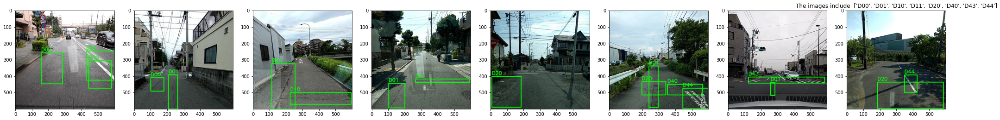

In [ ]:
fig = plt.figure()
fig.subplots_adjust(hspace=1, wspace=1)
fig, ax = plt.subplots(nrows=1, ncols=8, figsize=(36,36))
plt.title(f'The images include  {damageTypes}')
ix = 0
for damageType in damageTypes:
    tmp = []

    for gov in govs:
        file = open(base_path + gov + '/ImageSets/Main/%s_trainval.txt' %damageType, 'r')

        for line in file:
            line = line.rstrip('\n').split('/')[-1]

            if line.split(' ')[2] == '1':
                tmp.append(line.split(' ')[0]+'.xml')
        
    random.shuffle(tmp)
    for number, image in enumerate(tmp[0:1]):
        img = draw_images(image)
        ax[ix].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

    ix += 1

## Run model

###Imports

In [ ]:
!pip install tensorflow==1.4.1

     |████████████████████████████████| 41.2MB 67kB/s 
     |████████████████████████████████| 1.7MB 46.3MB/s 
     |████████████████████████████████| 890kB 49.3MB/s 
  Created wheel for html5lib: filename=html5lib-0.9999999-cp36-none-any.whl size=107220 sha256=dceef5ce92e4f2e4d440771c58574ea09cca96576ed231523a08b672dbed6af7
  Stored in directory: /root/.cache/pip/wheels/50/ae/f9/d2b189788efcf61d1ee0e36045476735c838898eef1cad6e29
Successfully built html5lib
  Found existing installation: html5lib 1.0.1
    Uninstalling html5lib-1.0.1:
      Successfully uninstalled html5lib-1.0.1
  Found existing installation: bleach 3.2.1
    Uninstalling bleach-3.2.1:
      Successfully uninstalled bleach-3.2.1
  Found existing installation: tensorflow 2.3.0
    Uninstalling tensorflow-2.3.0:
      Successfully uninstalled tensorflow-2.3.0


In [ ]:
import numpy as np
import sys
import tarfile
import tensorflow as tf
import zipfile
import os

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

if tf.__version__ != '1.4.1':
  print(tf.__version__)
  raise ImportError('Please upgrade your tensorflow installation to v1.4.1!')

###Object detection imports

In [ ]:
!pip install utils
!pip install tensorflow-object-detection-api

     |████████████████████████████████| 583kB 7.9MB/s 
     |████████████████████████████████| 61kB 7.9MB/s 
     |████████████████████████████████| 51kB 7.7MB/s 
     |████████████████████████████████| 2.6MB 27.3MB/s 
  Created wheel for tensorflow-object-detection-api: filename=tensorflow_object_detection_api-0.1.1-cp36-none-any.whl size=844515 sha256=8f4f042aa28e1b430d0557ca2b5de5045d1d540bbf20268b2e9583bb3b526756
  Stored in directory: /root/.cache/pip/wheels/4a/54/d0/cfca11930c4b2025d40dede77059094070a67cc3e7bd3b285f
Successfully built tensorflow-object-detection-api
ERROR: readme-renderer 28.0 has requirement bleach>=2.1.0, but you'll have bleach 1.5.0 which is incompatible.


In [ ]:
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:469: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:470: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:471: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:472: FutureWarning: Passing (type, 1) or 

### Model Preparation

In [ ]:
# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT =  'trainedModels/ssd_mobilenet_innference_graph.pb' 

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'trainedModels/crackLabelMap.txt' # IMPORTANT!! - Manualy add crackLabelMap.txt from the gitHub repo

NUM_CLASSES = 8

In [ ]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

In [ ]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

In [ ]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

### Detection

In [ ]:
# get images from val.txt
PATH_TO_TEST_IMAGES_DIR = '/content/RoadDamageDataset/'
D_TYPE = ['D00', 'D01', 'D10', 'D11', 'D20','D40', 'D43']
govs = ['Adachi', 'Ichihara', 'Muroran', 'Chiba', 'Sumida', 'Nagakute', 'Numazu']

val_list = []
for gov in govs:
    file = open(PATH_TO_TEST_IMAGES_DIR + gov + '/ImageSets/Main/val.txt', 'r')
    for line in file:
        line = line.rstrip('\n').split('/')[-1]
        val_list.append(line)
    file.close()

print("# of validation images：" + str(len(val_list)))

# of validation images：1813


In [ ]:
import random
TEST_IMAGE_PATHS=[]

random.shuffle(val_list)

for val_image in val_list[0:5]:
    TEST_IMAGE_PATHS.append(PATH_TO_TEST_IMAGES_DIR + val_image.split('_')[0]+ '/JPEGImages/%s.jpg' %val_image)
# Size, in inches, of the output images.
IMAGE_SIZE = (48, 16)

In [ ]:
total_scores = []
modified_score=[]

In [ ]:

def detection(modification=None, b=60):
  
  with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
      # Definite input and output Tensors for detection_graph
      image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
      # Each box represents a part of the image where a particular object was detected.
      detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
      # Each score represent how level of confidence for each of the objects.
      # Score is shown on the result image, together with the class label.
      detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
      detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
      num_detections = detection_graph.get_tensor_by_name('num_detections:0')
      
      # fig = plt.figure()
      # fig.subplots_adjust(hspace=1, wspace=1)
      # fig, ax = plt.subplots(nrows=1, ncols=3, figsize=IMAGE_SIZE)
      # idx = 0

      for image_path in TEST_IMAGE_PATHS:

        plt.figure().subplots_adjust(hspace=0.0, wspace=1)
        fig, (ax0, ax1, ax2) = plt.subplots(nrows=1, ncols=3, figsize=IMAGE_SIZE)

        image = Image.open(image_path)

        
        # the array based representation of the image will be used later in order to prepare the
        # result image with boxes and labels on it.
        image_np = load_image_into_numpy_array(image)
        hist_original = image_np.ravel()
        hist_modified = hist_original

        if modification is not None:
          # ==== Aqui modificar el codigo ===
          original = image_np
          if modification == 's&p':
            image_np, s_p_noise, original_lap  = noisy("s&p",image_np, amount = 0.4)
            psnr = cv2.PSNR(original, image_np)

            print('The PSNR score is', psnr)
            print('Laplacian of Original Image', original_lap)
            print('Laplacian with Noise', s_p_noise)
            print('                  ', )

            hist_modified = image_np.ravel()

          elif modification == 'gaussian':
            image_np, gauss_noise_lap, original_lap = noisy("gauss",image_np,var=1)
            psnr = cv2.PSNR(original, image_np)
            print('The PSNR score is', psnr)
            print('Laplacian of Original Image', original_lap)
            print('Laplacian with Noise', gauss_noise_lap)
            hist_modified = image_np.ravel()

          elif modification == 'contrast':
            image_np = add_img(image_np, b)
            psnr = cv2.PSNR(original, image_np)
            hist_modified = image_np.ravel()

          elif modification == 'equalization':
            R, G, B = cv2.split(image_np)
            output1_R = cv2.equalizeHist(R)
            output1_G = cv2.equalizeHist(G)
            output1_B = cv2.equalizeHist(B)
            image_np = cv2.merge((output1_R, output1_G, output1_B))
            hist_modified = image_np.ravel()

          elif modification == 'blur':
            print('The variance laplacian from the original image - ', cv2.Laplacian(image_np, cv2.CV_64F).var())
            image_np = cv2.blur(image_np, (5,5))
          
            print('The variance laplacian from the blur image - ', cv2.Laplacian(image_np, cv2.CV_64F).var())
            print('       ')
            hist_modified = image_np.ravel()

          else:
            pass # Do nothing
          
        # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
        image_np_expanded = np.expand_dims(image_np, axis=0)
        # Actual detection.
        (boxes, scores, classes, num) = sess.run(
            [detection_boxes, detection_scores, detection_classes, num_detections],
            feed_dict={image_tensor: image_np_expanded})
        A = np.squeeze(scores)
        total_scores.append(A[0])
        modified_score.append(A[0])
        # Visualization of the results of a detection.
        vis_util.visualize_boxes_and_labels_on_image_array(
            image_np,
            np.squeeze(boxes),
            np.squeeze(classes).astype(np.int32),
            np.squeeze(scores),
            category_index,
            min_score_thresh=0.3,
            use_normalized_coordinates=True,
            line_thickness=8)
        
        
        
        ax0.imshow(image_np)
        ax0.set_title(image_path.split('/')[-1].split('_')[0])
        ax1.hist(hist_original, bins=32, range=(0.0, 255), fc='k', ec='k') 
        ax1.set_title('Histogram of original image')
        ax2.hist(hist_modified, bins=32, range=(0.0, 255), fc='k', ec='k')
        ax2.set_title('Histogram of modified image')
        plt.show()

        # ax[idx].set_title(image_path.split('/')[-1].split('_')[0])
        # ax[idx].imshow(image_np)
        # idx += 1
    return modified_score


[0.9856329, 0.8716114, 0.46618015, 0.9357894, 0.9044286]


<Figure size 432x288 with 0 Axes>

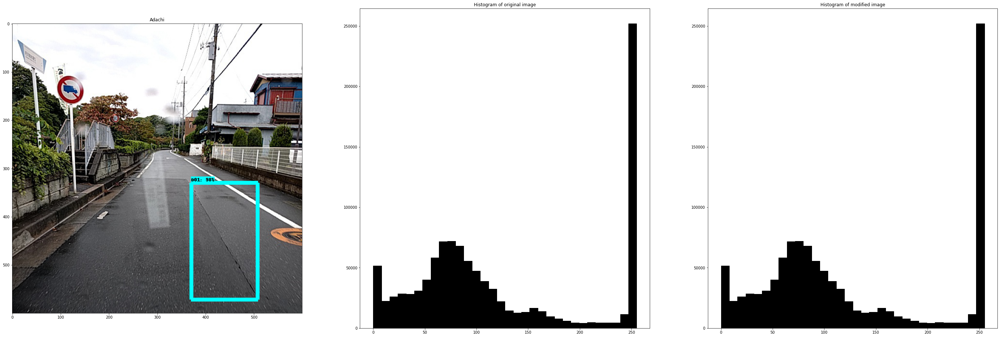

<Figure size 432x288 with 0 Axes>

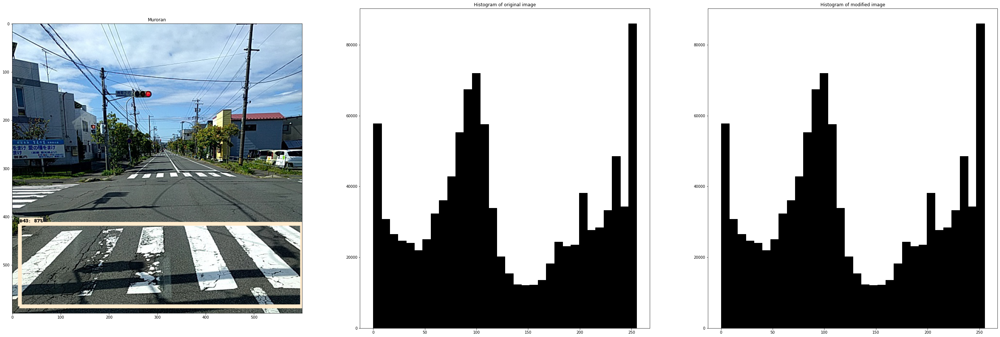

<Figure size 432x288 with 0 Axes>

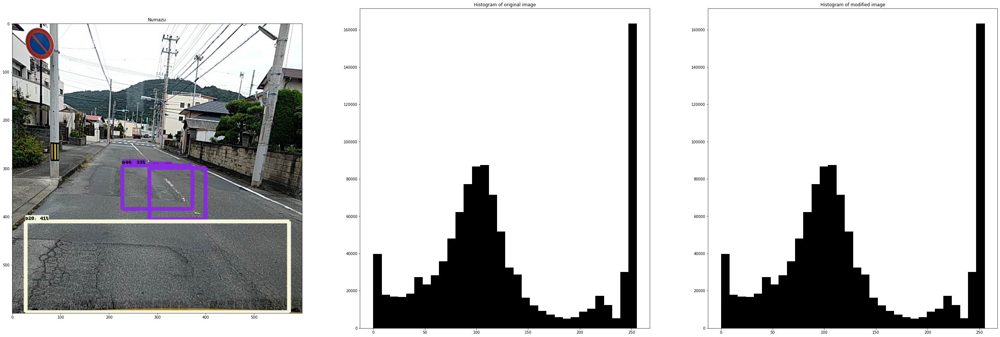

<Figure size 432x288 with 0 Axes>

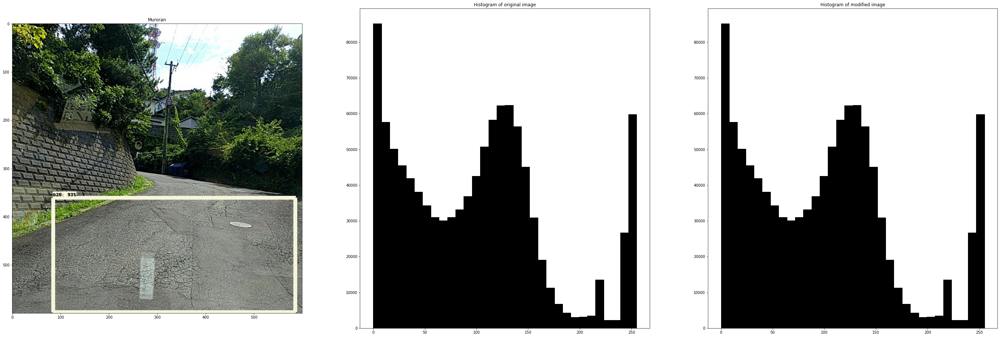

<Figure size 432x288 with 0 Axes>

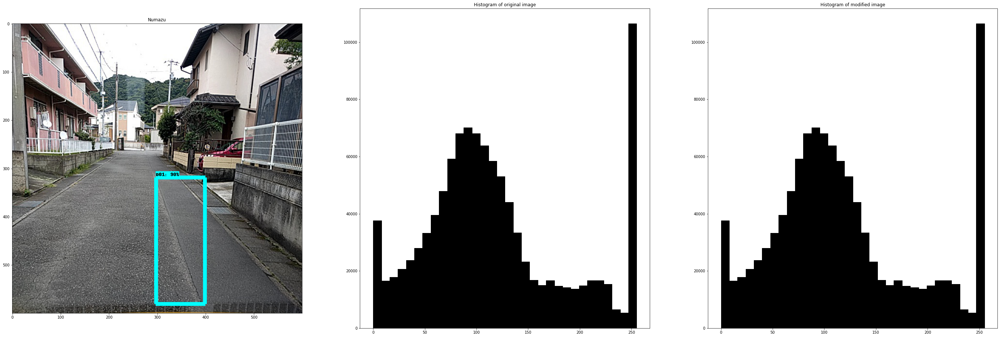

In [ ]:
detection()
print(total_scores)

[]

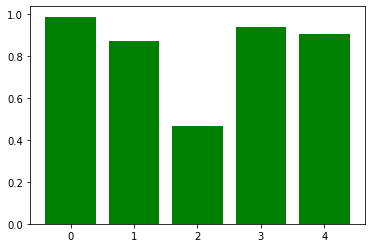

In [ ]:
x = np.arange(0,len(total_scores))
plt.bar(x, total_scores, color='g')
plt.plot()

## Running modified images

### Function for adding noise

In [ ]:
def noisy(noise_typ,image,mean=0, var=0.1, amount = 0.004):
   row,col,ch= image.shape
   original_lap = cv2.Laplacian(image, cv2.CV_64F).var()
   if noise_typ == "gauss":
      sigma = var**0.5
      gauss = np.random.normal(mean,sigma,(row,col,ch))
      
    
      #gauss = gauss.reshape(row,col,ch)
      noisy = image + gauss
      gauss_noise_lap = cv2.Laplacian(noisy, cv2.CV_64F).var()
      return noisy,gauss_noise_lap, original_lap
   elif noise_typ == "s&p":
      s_vs_p = 0.5#cv2.Laplacian(image, cv2.CV_64F).var()
      
      out = np.copy(image)
      # Salt mode
      num_salt = np.ceil(amount * image.size * s_vs_p)
      coords = [np.random.randint(0, i - 1, int(num_salt))
              for i in image.shape]
      out[coords] = 1

      # Pepper mode
      num_pepper = np.ceil(amount* image.size * (1. - s_vs_p))
      coords = [np.random.randint(0, i - 1, int(num_pepper))
              for i in image.shape]
      out[coords] = 0
      s_p_noise = cv2.Laplacian(out, cv2.CV_64F).var()
      return out, s_p_noise, original_lap

def convert_to_uint8(image_in):
    temp_image = np.float64(np.copy(image_in))
    cv2.normalize(temp_image, temp_image, 0, 255, cv2.NORM_MINMAX, dtype=-1)

    return temp_image.astype(np.uint8)

### Salt and peper noise

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:21: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


The PSNR score is 9.9347609377895
Laplacian of Original Image 2444.7431082075705
Laplacian with Noise 73840.69981609753
                  
The PSNR score is 10.520330084867549
Laplacian of Original Image 4498.0327962528945
Laplacian with Noise 65331.28522231755
                  
The PSNR score is 10.38174628683841
Laplacian of Original Image 3355.7404404156146
Laplacian with Noise 67047.97566189975
                  
The PSNR score is 11.969187118244973
Laplacian of Original Image 4681.1137833425855
Laplacian with Noise 47760.70775776188
                  
The PSNR score is 10.733511105075046
Laplacian of Original Image 4520.015298149957
Laplacian with Noise 62714.61417383404
                  


<Figure size 432x288 with 0 Axes>

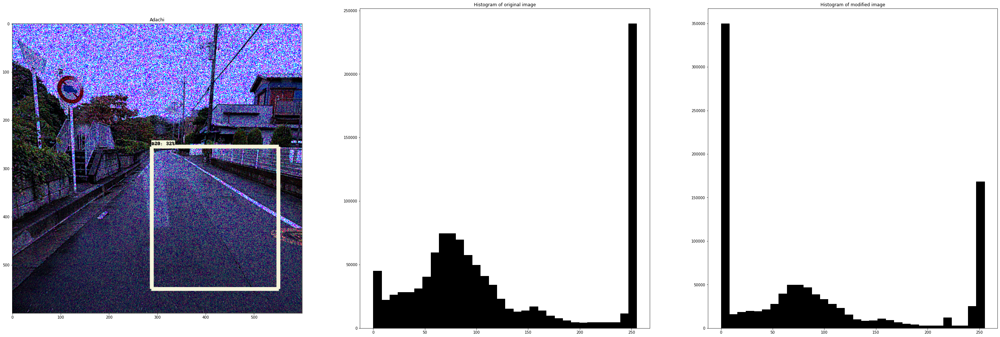

<Figure size 432x288 with 0 Axes>

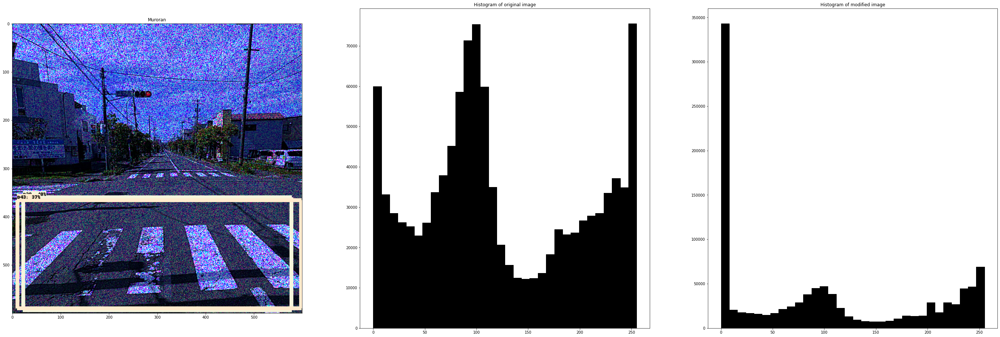

<Figure size 432x288 with 0 Axes>

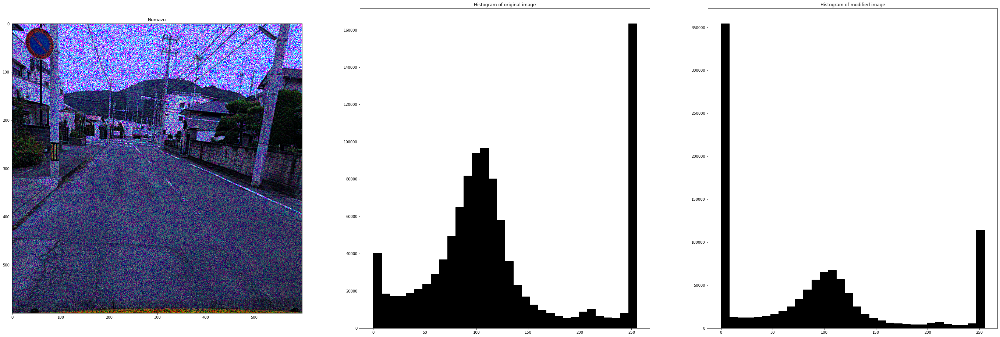

<Figure size 432x288 with 0 Axes>

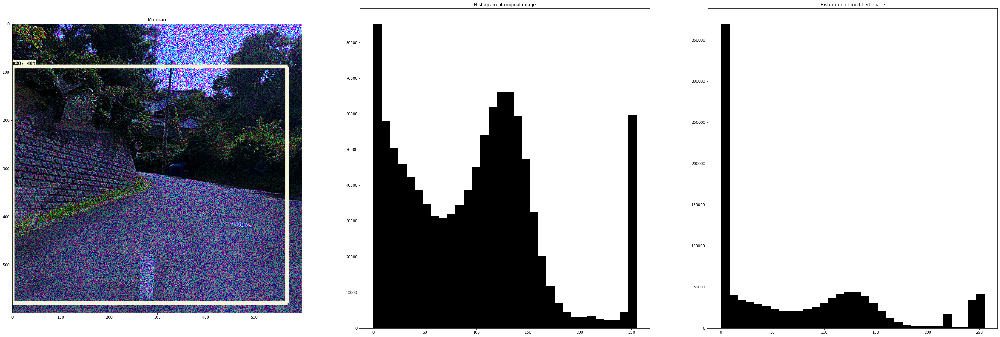

<Figure size 432x288 with 0 Axes>

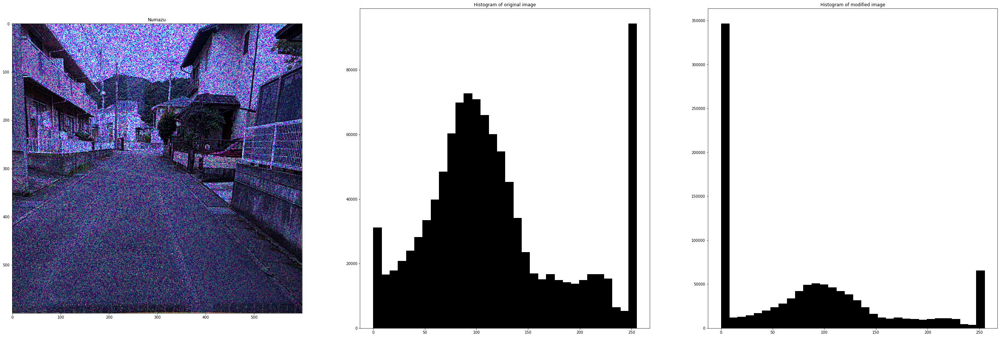

In [ ]:
modified_score = detection('s&p')

[]

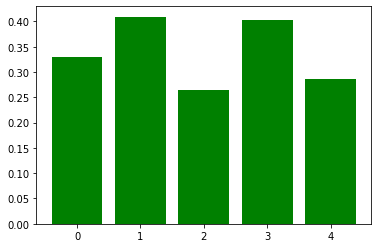

In [ ]:

x = np.arange(0,len(modified_score))
plt.bar(x, modified_score, color='g')
plt.plot()

### Contrast

<Figure size 432x288 with 0 Axes>

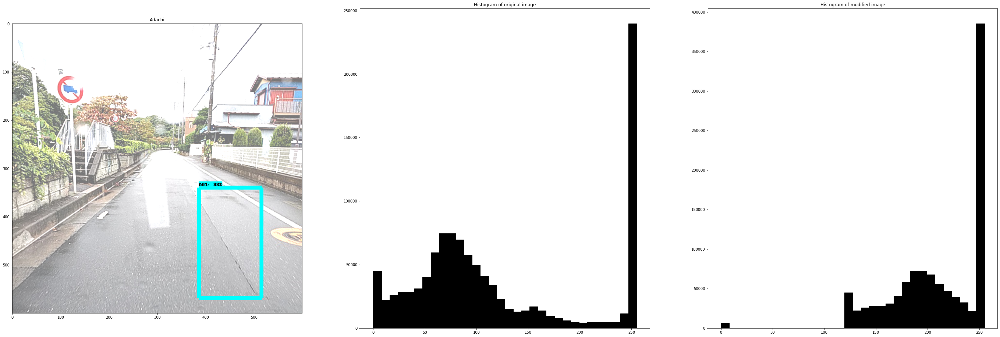

<Figure size 432x288 with 0 Axes>

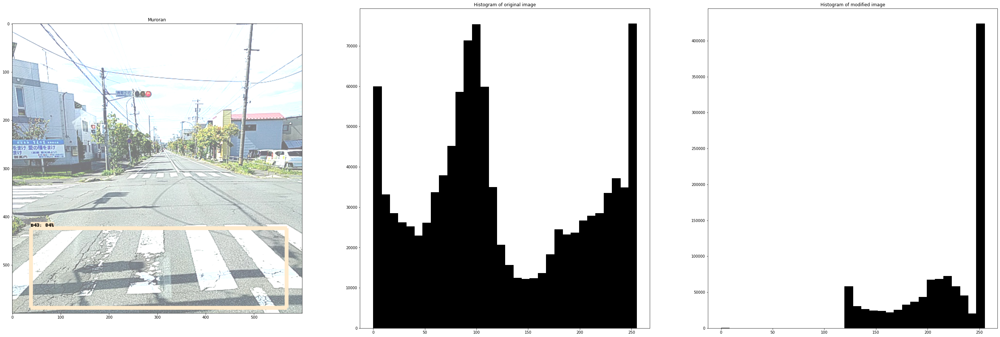

<Figure size 432x288 with 0 Axes>

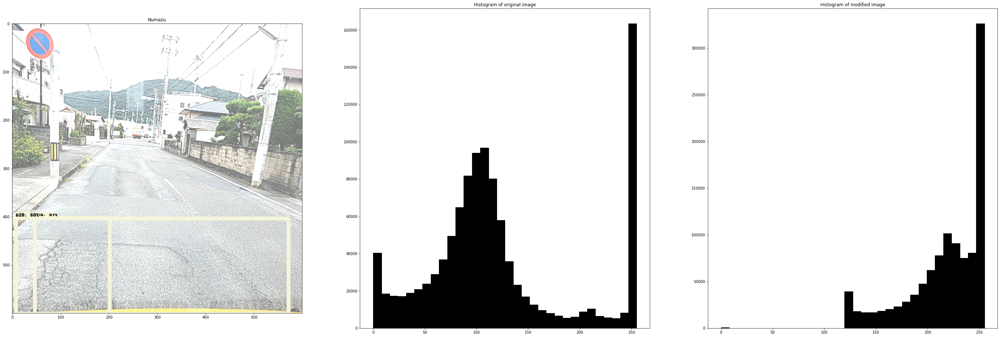

<Figure size 432x288 with 0 Axes>

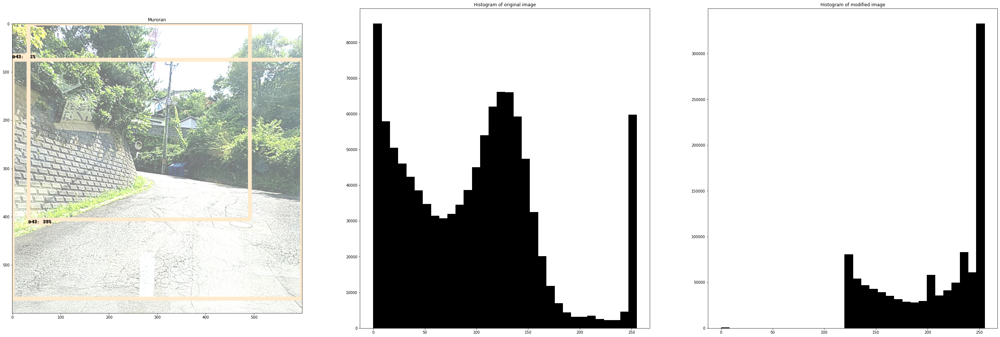

<Figure size 432x288 with 0 Axes>

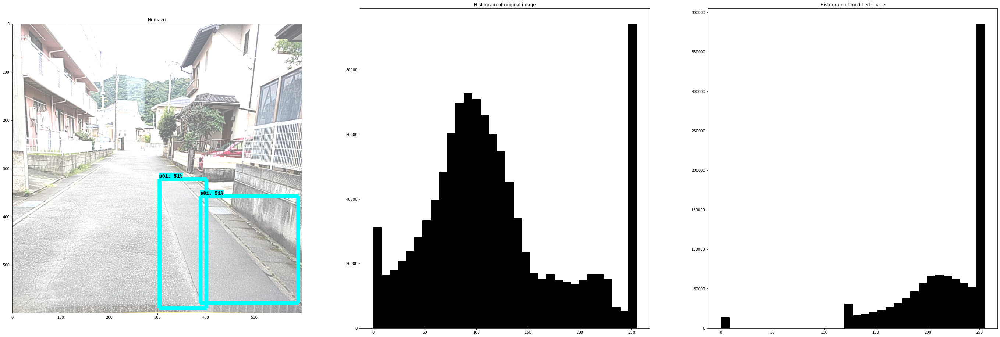

In [ ]:

def add_img(img,b):
  return np.minimum(img.astype("uint16") + b, 255*np.ones_like(img)).astype("uint8")

modified_score = detection('contrast', b=120)

[]

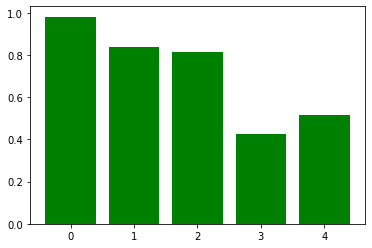

In [ ]:

x = np.arange(0,len(modified_score))
plt.bar(x, modified_score, color='g')
plt.plot()

### Equalization

<Figure size 432x288 with 0 Axes>

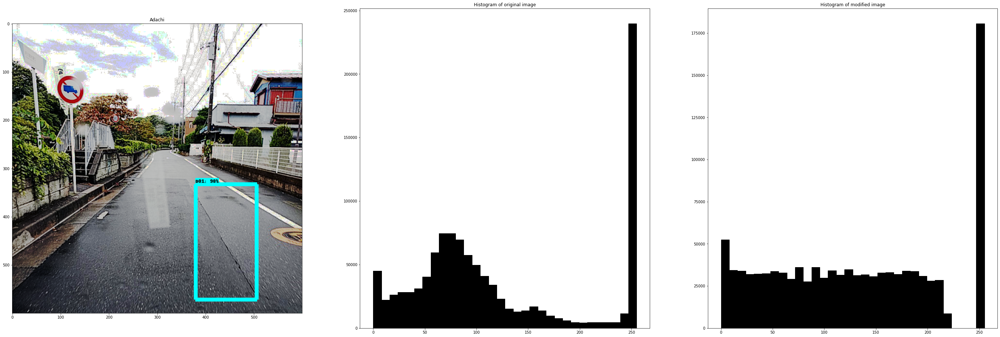

<Figure size 432x288 with 0 Axes>

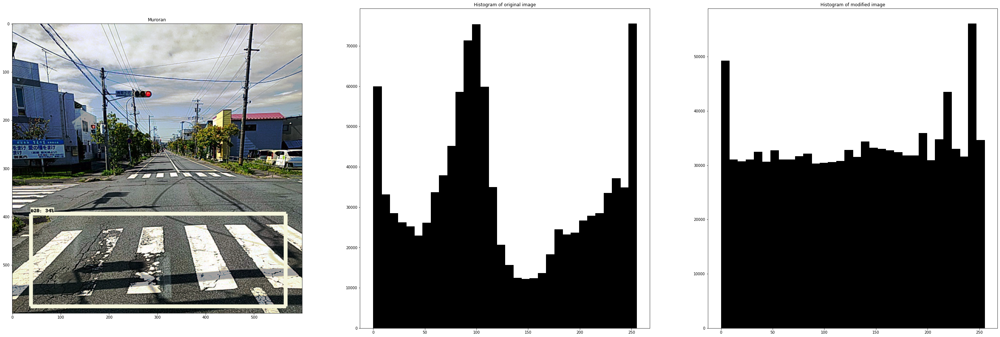

<Figure size 432x288 with 0 Axes>

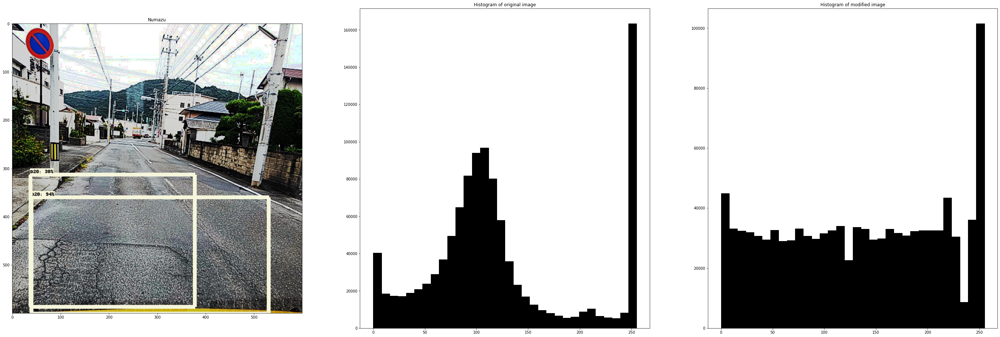

<Figure size 432x288 with 0 Axes>

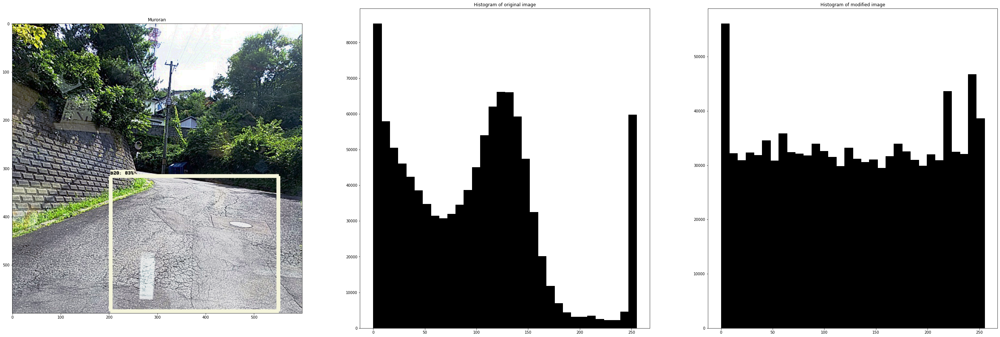

<Figure size 432x288 with 0 Axes>

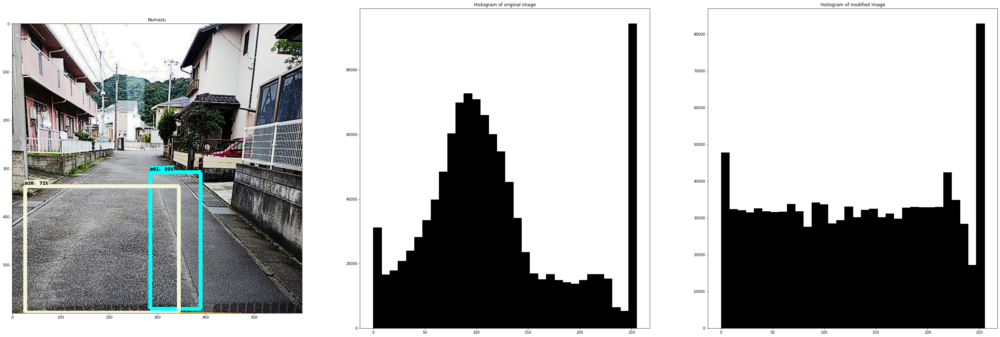

In [ ]:
modified_score = detection('equalization')

[]

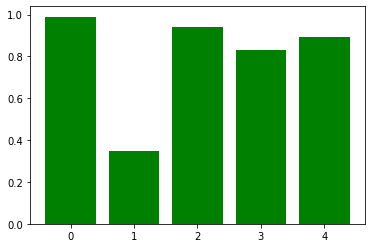

In [ ]:
x = np.arange(0,len(modified_score))
plt.bar(x, modified_score, color='g')
plt.plot()

### Blur

The variance laplacian from the original image -  2444.7431082075705
The variance laplacian from the blur image -  55.3150703265809
       
The variance laplacian from the original image -  4498.0327962528945
The variance laplacian from the blur image -  89.33073216567131
       
The variance laplacian from the original image -  3355.7404404156146
The variance laplacian from the blur image -  62.01983407067814
       
The variance laplacian from the original image -  4681.1137833425855
The variance laplacian from the blur image -  68.31753231404322
       
The variance laplacian from the original image -  4520.015298149957
The variance laplacian from the blur image -  93.72277820293209
       


<Figure size 432x288 with 0 Axes>

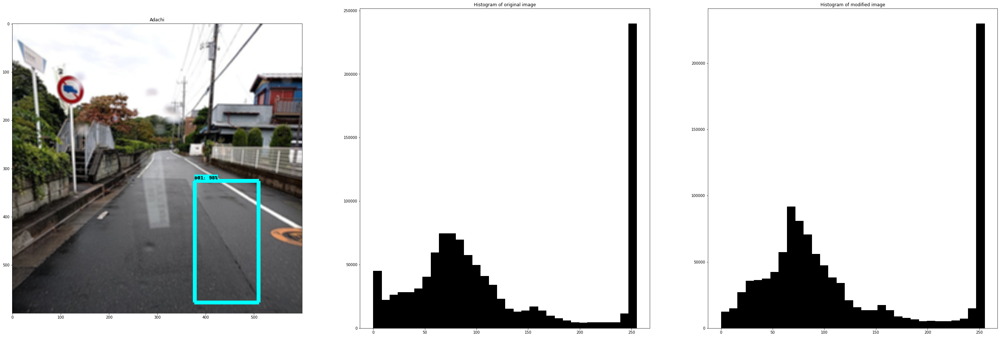

<Figure size 432x288 with 0 Axes>

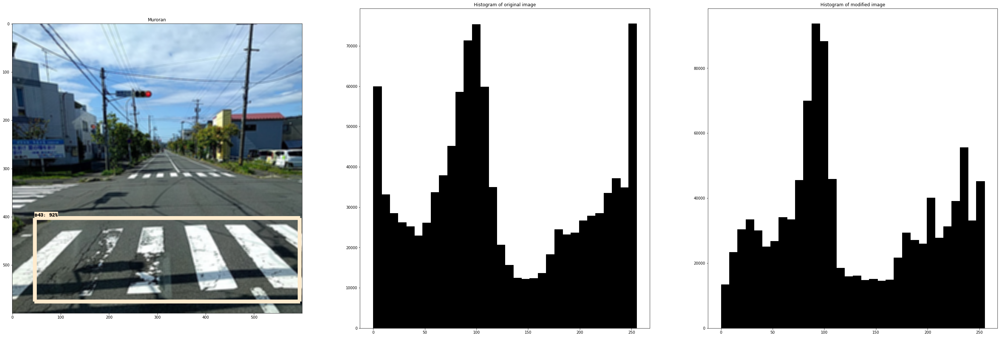

<Figure size 432x288 with 0 Axes>

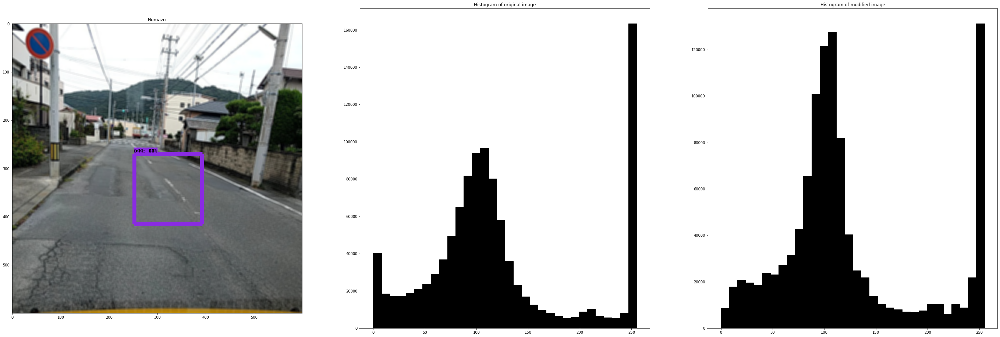

<Figure size 432x288 with 0 Axes>

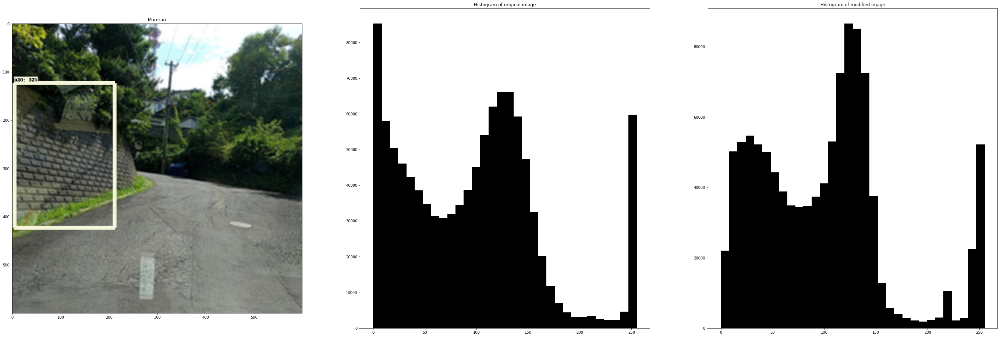

<Figure size 432x288 with 0 Axes>

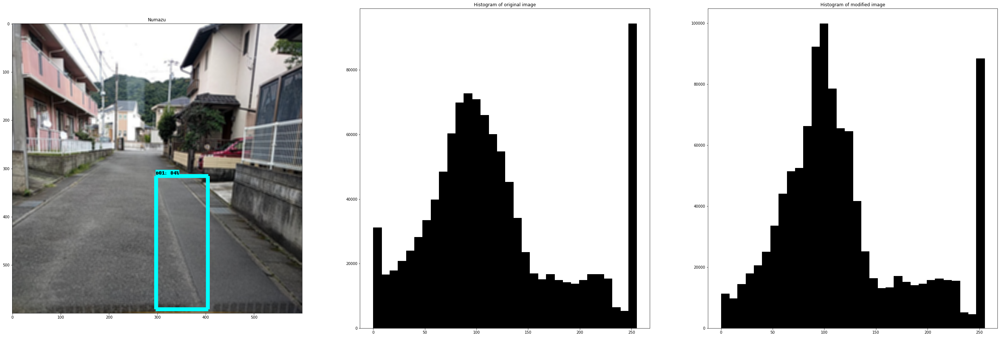

In [ ]:
modified_score = detection('blur')